<a href="https://colab.research.google.com/github/shay-dan/DS_workshop_OpenUIL/blob/main/Model_comparison.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#7.Model comparison:


Before we start the models comparison, there are a few issues we must mention, as they affect how we need to look at the results:

1.   Data:
*   The original dataset is 2978 images with 20 different classes
*   After preproccessing and EDA, we dropped 53 images with bad annotations, and performed multiple random augmentations on the rest of the data to increase class balance, giving us a new dataset of 6300 augmented images.

2. Image size:
*   As we saw in the preproccessing/EDA, image height is ranging from 378 up to 816, with most at 612 width, while width ranges from 504 to 816, with most at 816. with our augmentations, we only changed image size for a small fraction of the data.  
*   However, we performed more resizing (mostly downsizing) on the data due to colab crashing on multiple reasons:

      a. when we looked at different features in EDA, we had to downsize all the images to (256,256) to be able to extract HOG discriptors for clustering
    
      b. when we built a classifier based on those features, we used image size of (80,80) as bigger size led to crashes.
    
      c. the same input was used for Random Forest

      d. when we used VGG16 as classifier, we resized our input to (128,128)

      e. on Detectron2 we haven't changed the input size, as it is capabale of dealing with different image size. however the model itself deploys severl resizings while training or validating.

      f. on YOLOv8, we used the default (640,640) input size.


*   For the reasons mentioned, we need to keep in mind that the inputs aren't equal, and that downsizing can lead to information loss, of which we actually saw when ploting the images vs HOG features.
This of course may account for the perfomance of SGD/SVM + HOG being much worse than the others (the other posibillity is obviously that the other models are much more advanced). we belive it's a combination of the two.

3. Data split:

*   We split our data to train/val/test, with 5000/1100/200 respectively.
however, on some of the models we haven't used the same split:

      a. for SGD/SVM + HOG, Random Forest and VGG16, we used train + val as the training set, i.e. we trained on 6100 images, and tested with the 200 images from the test set. we chose to avoid validation since we
    
      b. for Detectron2 and YOLO, we used the split as is, which means that the training was done on 5000 images only.

4. Training hyperparameters:

*   All of our models used different hyperparameters, for example number of iterations (SGD), different HOG parameters (GridSearch), number of estimators (Random Forest) and more.
*   For our deep learning models - VGG16, Detectron2 and YOLO, we used the default hyperparameters (loss function, optimizer, and more). we only changed number of iterations and epochs, to try to "keep it clean".

5. Metrics:

*   The object detection models have more metrics that aren't used for the classifiers, i.e. mAP, mAP50-95, so we only made comparisons where we could.



Now that we mentioned the issues with the comparison, we'll start by comparing the classifications metrics - i.e. precision,recall, accuracy and F1 score and then we continue to compare Detectron2 vs YOLOv8 on mAP metrics. we will also show actual predictions with images.

Precision:

Precision measures how well you can find true positives(TP) out of all positive predictions. (TP+FP).

Recall:

Recall measures how well you can find true positives(TP) out of all predictions(TP+FN)

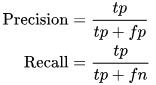

Accuracy:

A measure of all "correct" classifications over all classifications. it can be a misleading metric for imbalanced data sets.

(for example, a dataset with 95 negative and 5 positive values would lead to 95% accuracy even if we automatically classify all values as negative)

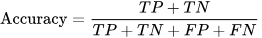

F1 score:

Finds the most optimal confidence score threshold where precision and recall give the highest F1 score. The F1 score calculates the balance between precision and recall. If the F1 score is high, precision and recall are high, and vice versa.

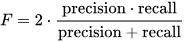


We will show classification reports - which combine precision, recall and F1 scores together:

## Precision, Recall, F1 score - classification reports for classifiers:

In [ ]:
svm_results = open("/content/drive/MyDrive/ColabNotebooks/models/sgd_svm_results.pkl","rb")
rf_results = open("/content/drive/MyDrive/ColabNotebooks/models/rf_results.pkl","rb")
vgg_results = open("/content/drive/MyDrive/ColabNotebooks/models/VGG_results.pkl","rb")

svm_results_unpacked = pd.read_pickle(svm_results)
rf_results_unpacked = pd.read_pickle(rf_results)
vgg_results_unpacked = pd.read_pickle(vgg_results)

print("Accuracy:")
print("SGD with HOG discriptos:", svm_results_unpacked[0])
print("SVM (grid search) with HOG discriptos:", svm_results_unpacked[5])
print("RF with HOG discriptos - 100 estimators:",rf_results_unpacked[0])
print("RF with HOG discriptos - 250 estimators:",rf_results_unpacked[3])
print("RF with VGG extracted features:",vgg_results_unpacked[0])
print("VGG16 neural network:",vgg_results_unpacked[3])

Accuracy:
SGD with HOG discriptos: 55.0
SVM (grid search) with HOG discriptos: 77.0
RF with HOG discriptos - 100 estimators: 0.835
RF with HOG discriptos - 250 estimators: 0.85
RF with VGG extracted features: 0.94
VGG16 neural network: 0.985


In [ ]:
print("SGD with HOG discriptos classification report:\n", svm_results_unpacked[2])
print("RF with HOG discriptos 100 estimators classification report:\n",rf_results_unpacked[2])
print("RF with HOG discriptos 250 estimators classification report:\n",rf_results_unpacked[5])
print("RF with VGG extracted features classification report:\n",vgg_results_unpacked[2])
print("VGG16 classification report:\n",vgg_results_unpacked[5])

SGD with HOG discriptos classification report:
                    precision    recall  f1-score   support

            apple       0.30      0.70      0.42        10
           banana       0.67      0.60      0.63        10
            bread       0.75      0.30      0.43        10
              bun       0.50      0.30      0.37        10
         doughnut       0.56      0.50      0.53        10
              egg       0.62      0.50      0.56        10
fired_dough_twist       0.67      0.60      0.63        10
            grape       1.00      0.90      0.95        10
            lemon       0.86      0.60      0.71        10
           litchi       1.00      0.80      0.89        10
            mango       0.33      0.80      0.47        10
              mix       0.70      0.70      0.70        10
         mooncake       0.78      0.70      0.74        10
           orange       0.33      0.50      0.40        10
            peach       0.33      0.50      0.40        10
       

Not surprising - we can see that better features and/or better models lead to better classifications.

Now we show some confusion matrices:

##Confusion Matrices for classifiers:

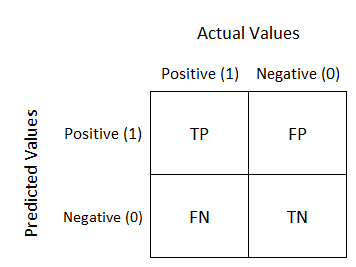

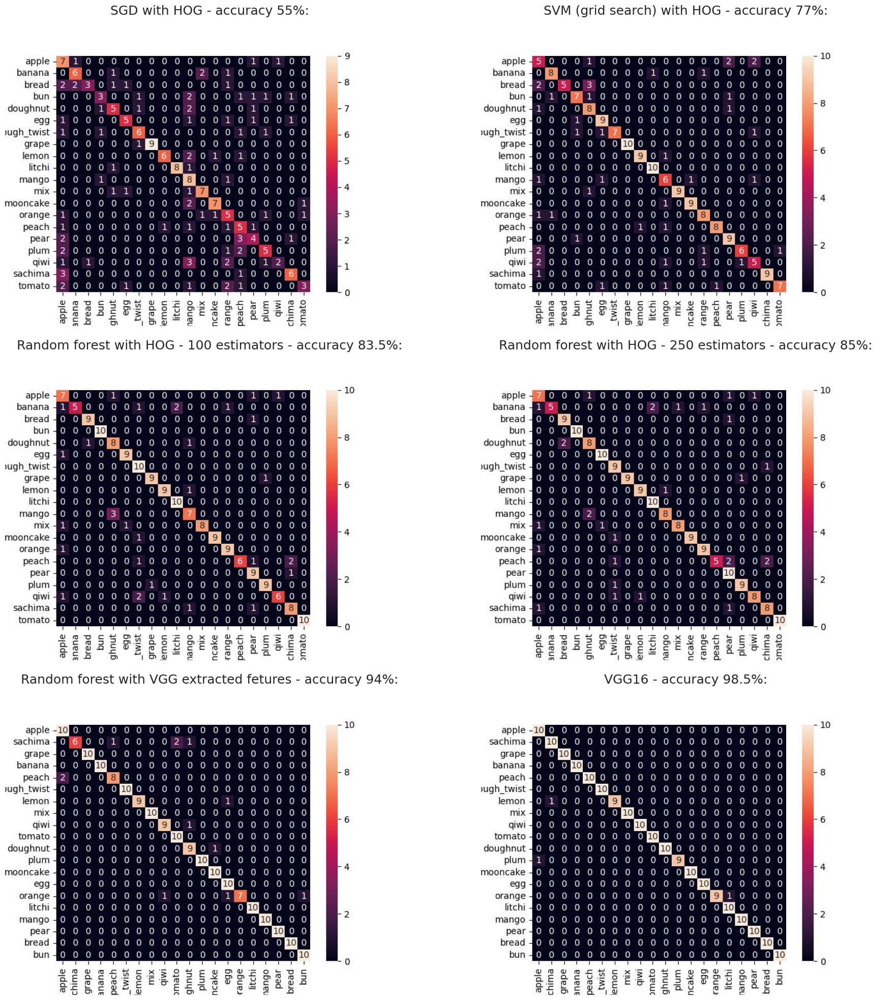

In [ ]:
fig, axes = plt.subplots(figsize=(20,20), ncols=2, nrows=3)
im = cv2.imread("/content/drive/MyDrive/ColabNotebooks/models/confusion_matrix_sgd.jpg")
im = cv2.cvtColor(im, cv2.COLOR_BGR2RGB)
axes[0,0].imshow(im)
axes[0,0].title.set_text('SGD with HOG - accuracy 55%:')
axes[0,0].axis('off')
im = cv2.imread("/content/drive/MyDrive/ColabNotebooks/models/confusion_matrix_svm.jpg")
im = cv2.cvtColor(im, cv2.COLOR_BGR2RGB)
axes[0,1].imshow(im)
axes[0,1].title.set_text('SVM (grid search) with HOG - accuracy 77%:')
axes[0,1].axis('off')
im = cv2.imread("/content/drive/MyDrive/ColabNotebooks/models/rf_hog.jpg")
im = cv2.cvtColor(im, cv2.COLOR_BGR2RGB)
axes[1,0].imshow(im)
axes[1,0].title.set_text('Random forest with HOG - 100 estimators - accuracy 83.5%:')
axes[1,0].axis('off')
im = cv2.imread("/content/drive/MyDrive/ColabNotebooks/models/rf_best.jpg")
im = cv2.cvtColor(im, cv2.COLOR_BGR2RGB)
axes[1,1].imshow(im)
axes[1,1].title.set_text('Random forest with HOG - 250 estimators - accuracy 85%:')
axes[1,1].axis('off')
im = cv2.imread("/content/drive/MyDrive/ColabNotebooks/models/rf_cm_vgg.jpg")
im = cv2.cvtColor(im, cv2.COLOR_BGR2RGB)
axes[2,0].imshow(im)
axes[2,0].title.set_text('Random forest with VGG extracted fetures - accuracy 94%:')
axes[2,0].axis('off')
im = cv2.imread("/content/drive/MyDrive/ColabNotebooks/models/cm_vgg.jpg")
im = cv2.cvtColor(im, cv2.COLOR_BGR2RGB)
axes[2,1].imshow(im)
axes[2,1].title.set_text('VGG16 - accuracy 98.5%:')
axes[2,1].axis('off')
fig.tight_layout()
plt.show()

Now that we saw how our classifiers are doing, we'll look at our Object Detectors - Detectron2 and YOLOv8, using mAP scores:


mAP - mean average precision, is a metric usually used for Object Detection, and is comprised of 4 different metrics - confusion matrix, box IoU ,precision and recall.

We already saw are precision, recall and confusion matrix, so let's understand what box IoU is:

When we predict a bounding box we compare it with the ground truth bounding box, and we take the area overlapping (intersection) and devide it by the total area (union). The score runs from 0 to 1, where 0  means no overlapp - or bad predicted box, and 1 means perfect predicted box.

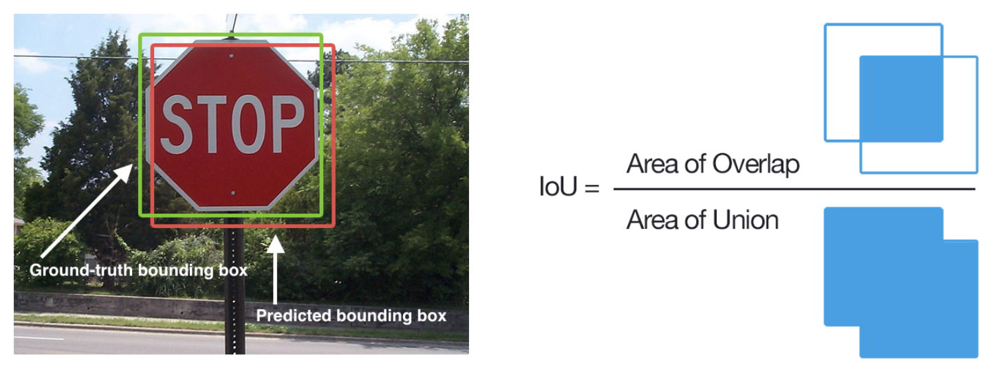

##Confusion Matrices for object detectors:

In [ ]:
from google.colab import drive
drive.mount('/content/drive/')

Mounted at /content/drive/


In [ ]:
import pickle
with open('/content/drive/MyDrive/ColabNotebooks/models/det2_val_res.pkl', 'rb') as f:
    coco_inference = pickle.load(f)

<Axes: >

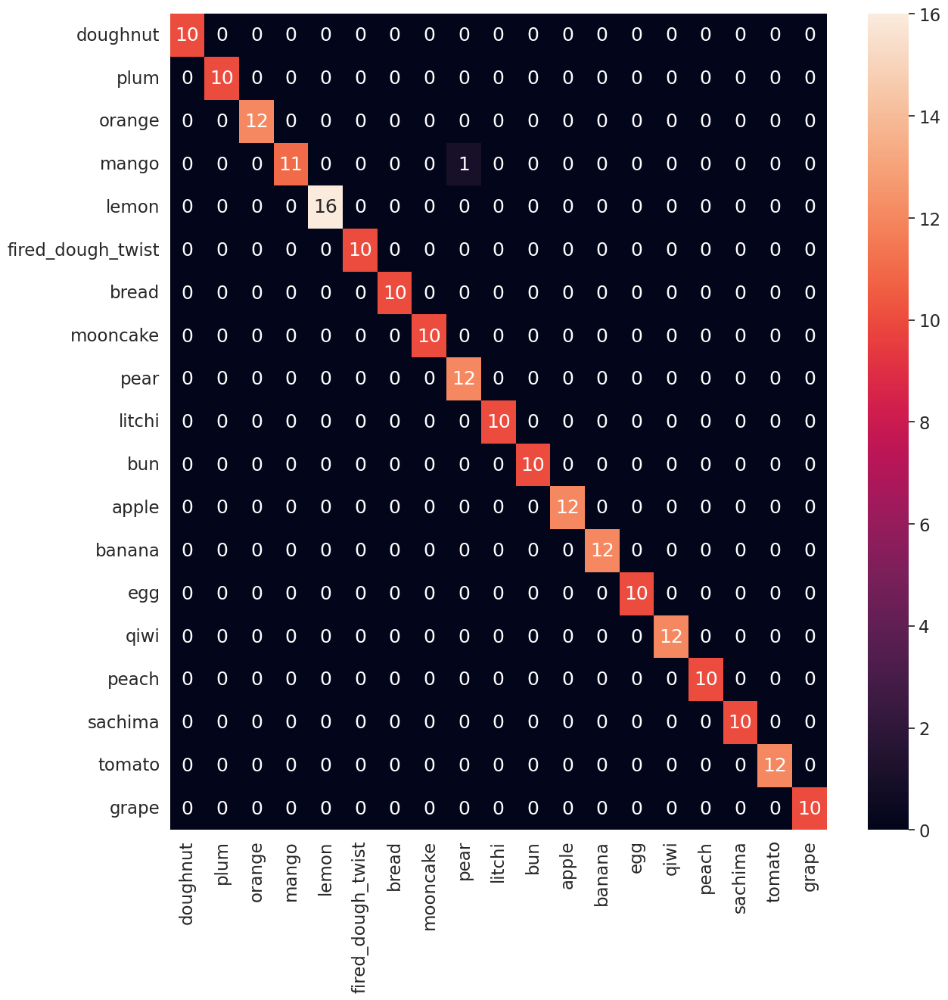

In [ ]:
plt.figure(figsize=(14, 14))
sns.heatmap(coco_inference[1], annot=True, xticklabels=True, yticklabels=True)


<Axes: >

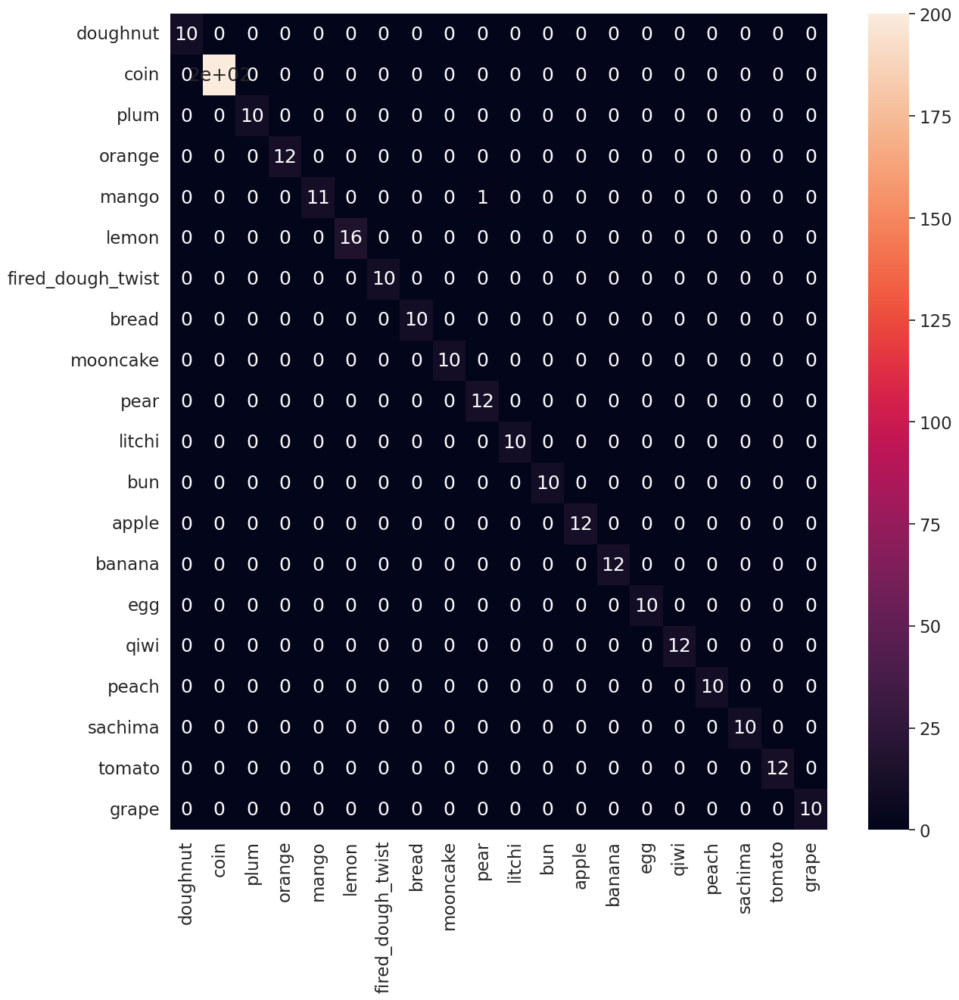

In [ ]:
plt.figure(figsize=(14, 14))
sns.heatmap(cm, annot=True, xticklabels=True, yticklabels=True)

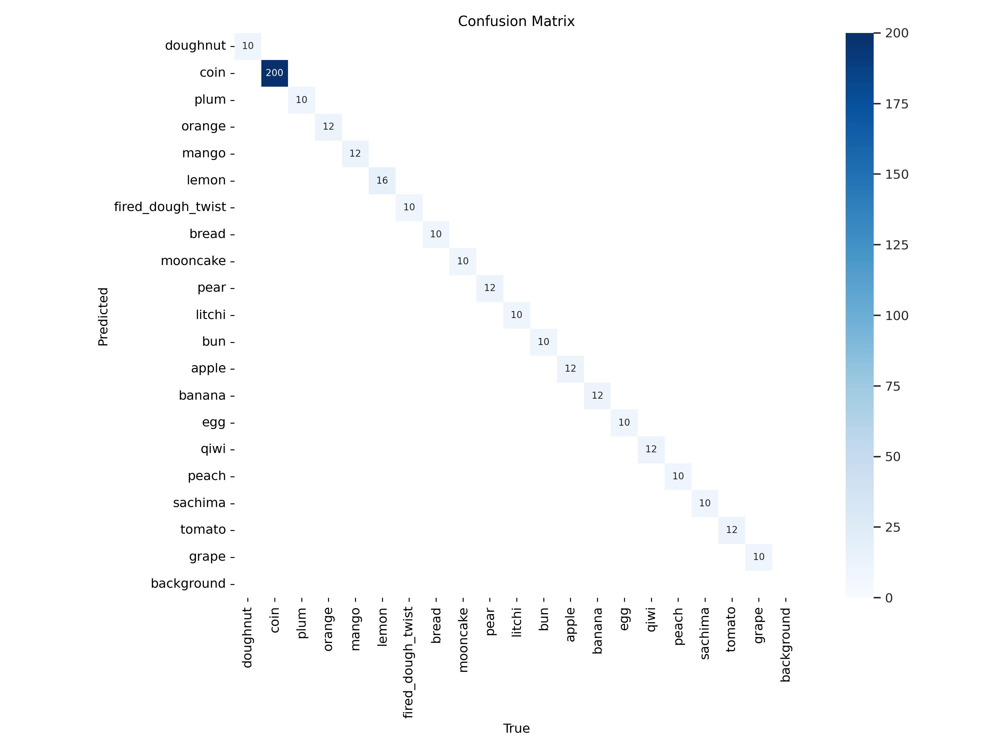

In [ ]:
Image(filename = "/content/drive/MyDrive/dataset_yolo/use_this_folder_only/results/100_epochs-test2/confusion_matrix.png", width = 1200)


We can see slightly better results with YOLO - one wrong prediction by Detectron2 was correct by YOLO

##mAP - Detectron2, YOLOv8

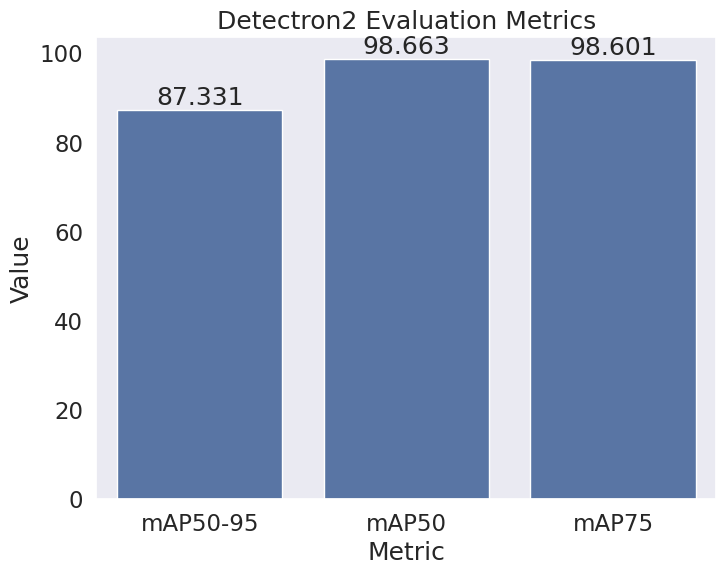

In [ ]:
coco_inf_dict = coco_inference[0]['bbox'].copy()

ax = sns.barplot(x=['mAP50-95', 'mAP50', 'mAP75'], y=[coco_inference[0]['bbox']['AP'], coco_inference[0]['bbox']['AP50'], coco_inference[0]['bbox']['AP75']])

ax.set_title('Detectron2 Evaluation Metrics')
ax.set_xlabel('Metric')
ax.set_ylabel('Value')

fig = plt.gcf()
fig.set_size_inches(8, 6)

for p in ax.patches:
    ax.annotate('{:.3f}'.format(p.get_height()), (p.get_x() + p.get_width() / 2, p.get_height()), ha='center', va='bottom')

plt.show()

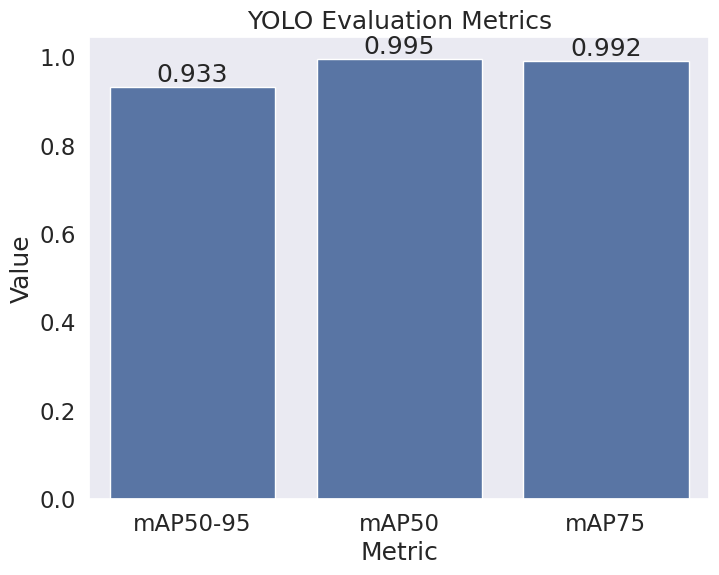

In [ ]:
ax = sns.barplot(x=['mAP50-95', 'mAP50', 'mAP75'], y=[metrics.box.map, metrics.box.map50, metrics.box.map75])

ax.set_title('YOLO Evaluation Metrics')
ax.set_xlabel('Metric')
ax.set_ylabel('Value')

fig = plt.gcf()
fig.set_size_inches(8, 6)

for p in ax.patches:
    ax.annotate('{:.3f}'.format(p.get_height()), (p.get_x() + p.get_width() / 2, p.get_height()), ha='center', va='bottom')

plt.show()

<ipython-input-27-0047f42c0d49>:26: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(ax.get_xticklabels(), rotation=90)


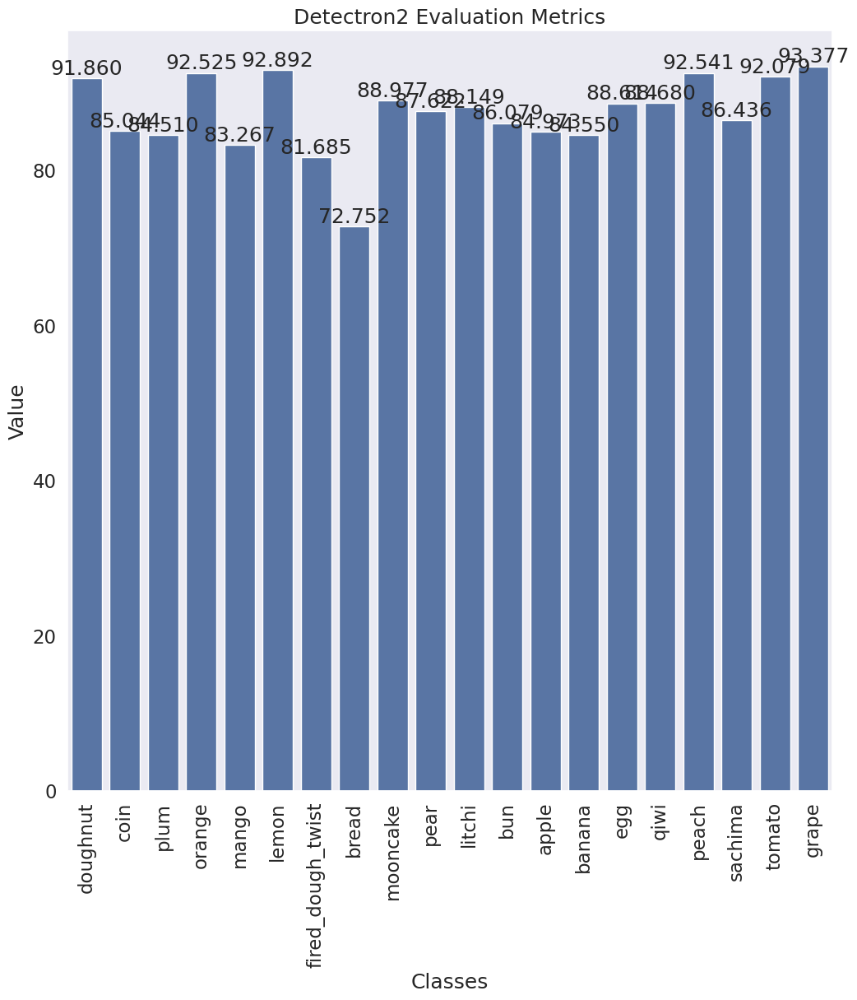

In [ ]:
delete = []
for i in coco_inf_dict.keys():
  if i.split("-")[0] != 'AP':
    delete.append(i)
delete.append('AP')
for i in delete:
  del coco_inf_dict[i]

classes = ['doughnut','coin','plum','orange','mango','lemon',
        'fired_dough_twist','bread','mooncake','pear',
        'litchi','bun','apple','banana','egg','qiwi',
        'peach','sachima','tomato','grape']

ax = sns.barplot(x=[cls for cls in classes], y=[map for map in coco_inf_dict.values()])

ax.set_title('Detectron2 Evaluation Metrics')
ax.set_xlabel('Classes')
ax.set_ylabel('Value')

fig = plt.gcf()
fig.set_size_inches(12, 12)

for p in ax.patches:
    ax.annotate('{:.3f}'.format(p.get_height()), (p.get_x() + p.get_width() / 2, p.get_height()), ha='center', va='bottom')

ax.set_xticklabels(ax.get_xticklabels(), rotation=90)

plt.show()

<ipython-input-28-d6f4eea00a51>:18: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(ax.get_xticklabels(), rotation=90)


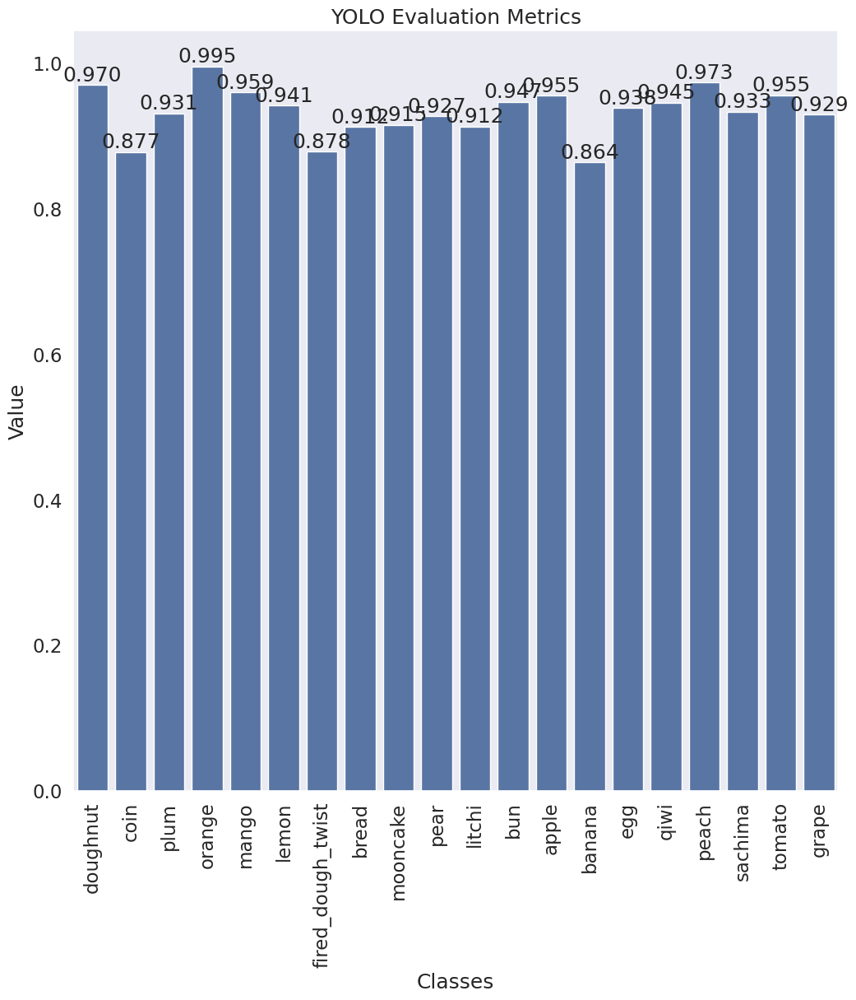

In [ ]:
classes = ['doughnut','coin','plum','orange','mango','lemon',
        'fired_dough_twist','bread','mooncake','pear',
        'litchi','bun','apple','banana','egg','qiwi',
        'peach','sachima','tomato','grape']

ax = sns.barplot(x=[cls for cls in classes], y=[map for map in metrics.box.maps],)

ax.set_title('YOLO Evaluation Metrics')
ax.set_xlabel('Classes')
ax.set_ylabel('Value')

fig = plt.gcf()
fig.set_size_inches(12, 12)

for p in ax.patches:
    ax.annotate('{:.3f}'.format(p.get_height()), (p.get_x() + p.get_width() / 2, p.get_height()), ha='center', va='bottom')

ax.set_xticklabels(ax.get_xticklabels(), rotation=90)

plt.show()


It looks like YOLO is doing a little bit better. Let's now see how the predictions look together:

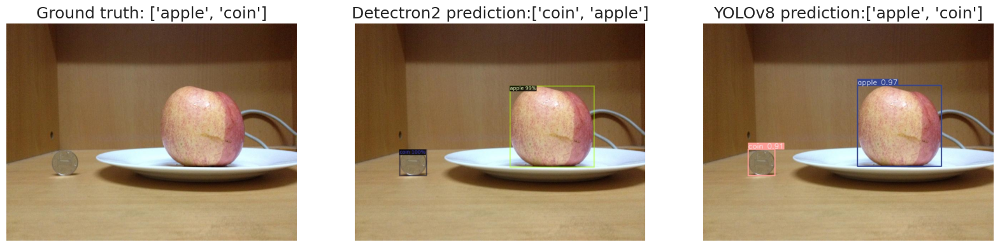

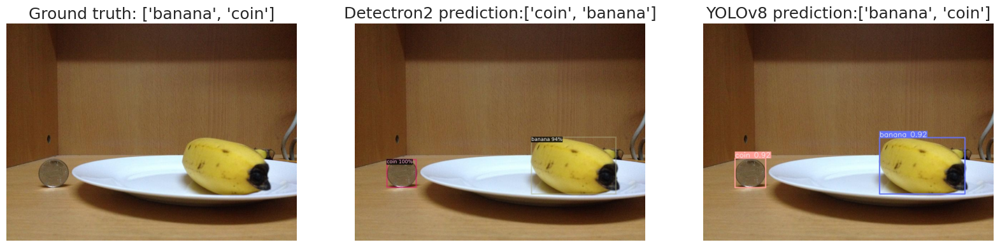

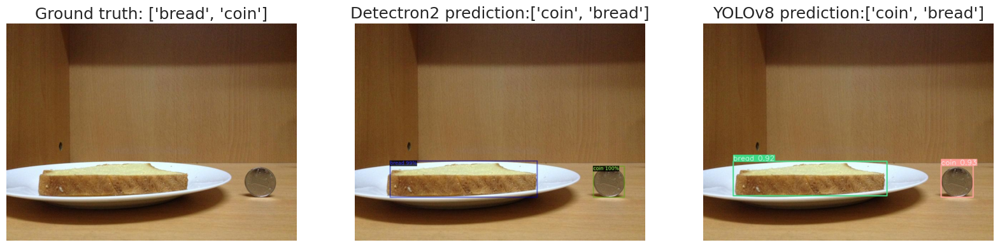

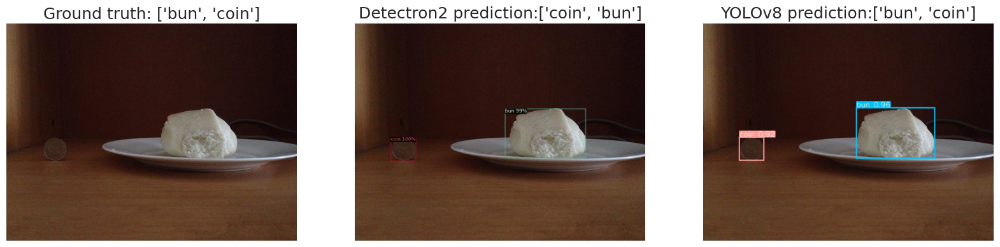

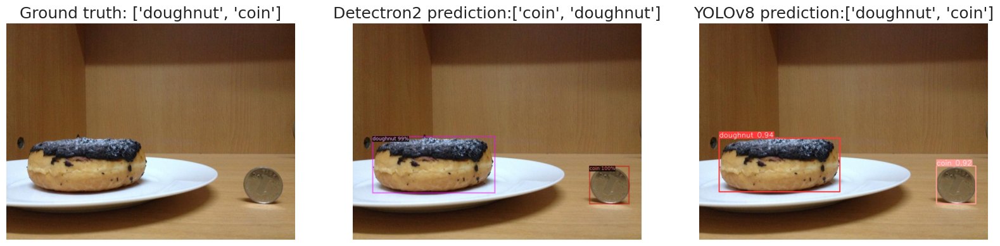

...

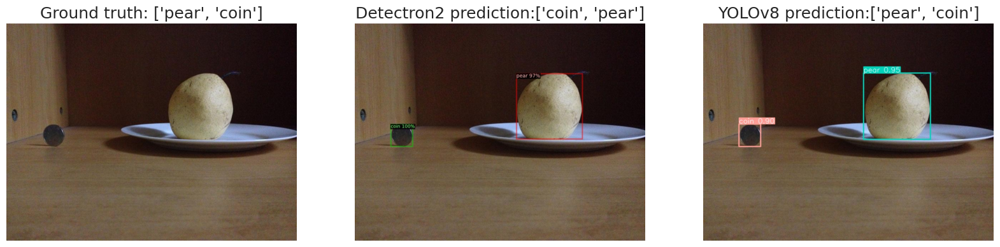

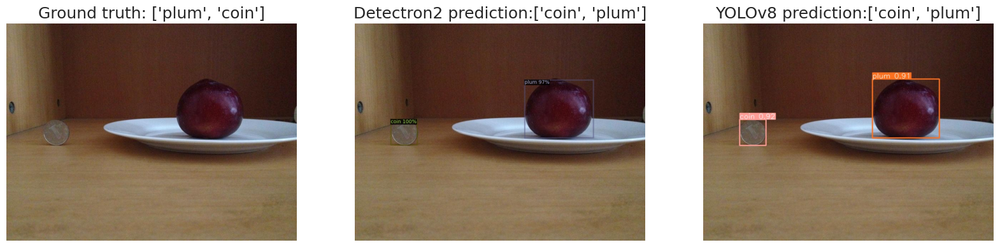

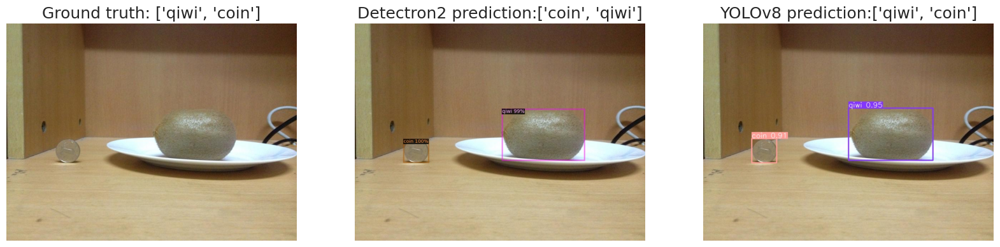

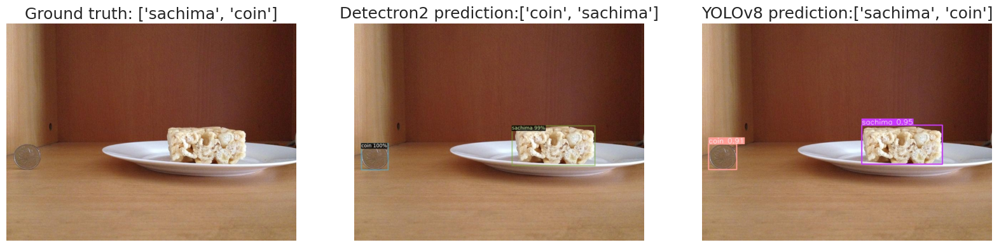

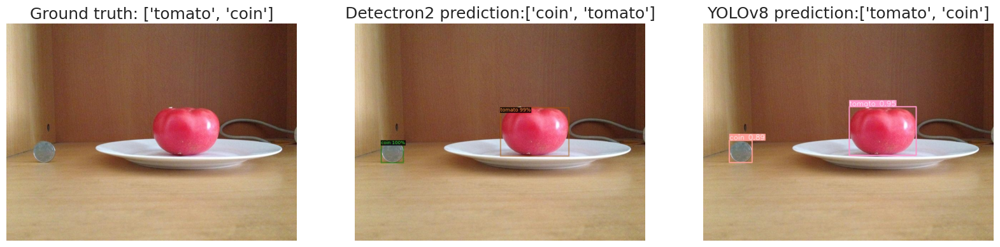

In [ ]:
df_det = pd.read_csv("/content/drive/MyDrive/res/Detectron2_test_results/output_objects_detectron2.csv")
df_det = df_det.sort_values(by='image_with_preds', ascending=True)
df_det = df_det.reset_index(drop=True)
df_yolo = pd.read_csv("/content/drive/MyDrive/dataset_yolo/use_this_folder_only/results/100_epochs-test/output_objects_yolo.csv")
df_yolo = df_yolo.sort_values(by='image_with_preds', ascending=True)
df_yolo = df_yolo.reset_index(drop=True)
for i,im in enumerate(df_det["image_with_preds"]):
  if i%10 == 0:
    fig, axes = plt.subplots(figsize=(20,20), ncols=3, nrows=1)
    image = cv2.imread(df_det["image"][i])
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    label = df_det["og_class"][i]
    axes[0].imshow(image)
    axes[0].title.set_text('Ground truth: ' + label)
    axes[0].axis('off')
    image = cv2.imread(df_det["image_with_preds"][i])
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    label = df_det["pred_class"][i]
    axes[1].imshow(image)
    axes[1].title.set_text('Detectron2 prediction:' + label)
    axes[1].axis('off')
    image = cv2.imread(df_yolo["image_with_preds"][i])
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    label = df_yolo["pred_class"][i]
    axes[2].imshow(image)
    axes[2].title.set_text('YOLOv8 prediction:' + label)
    axes[2].axis('off')
    plt.show()

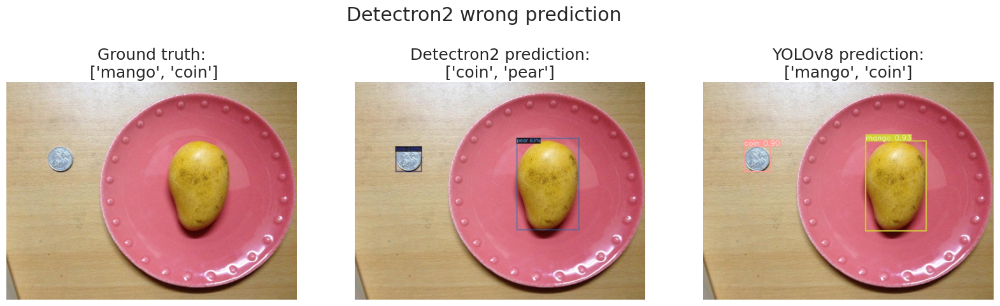

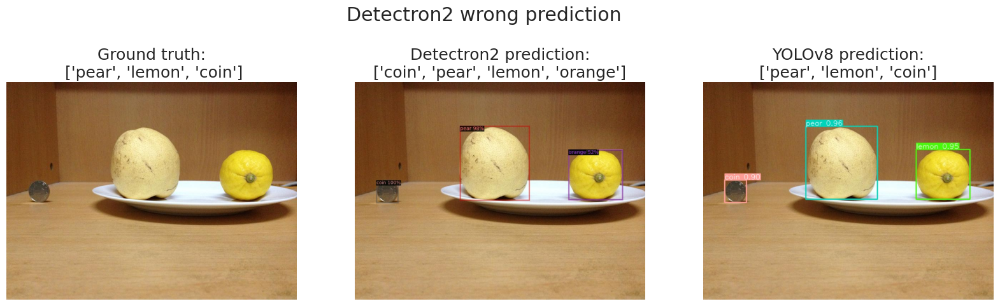

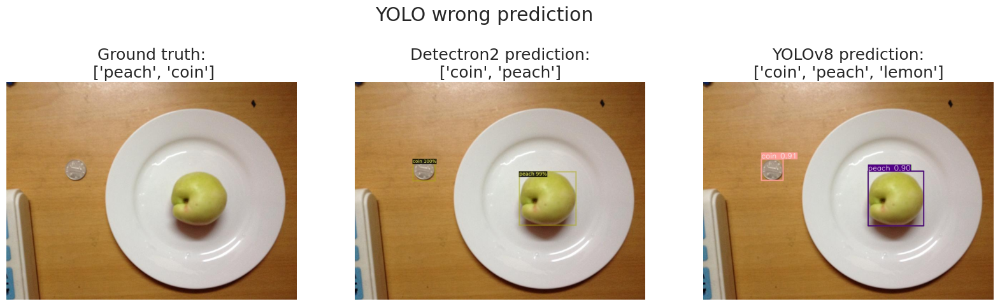

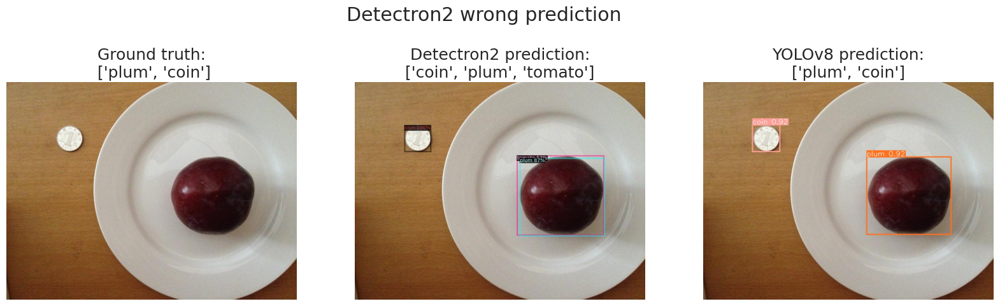

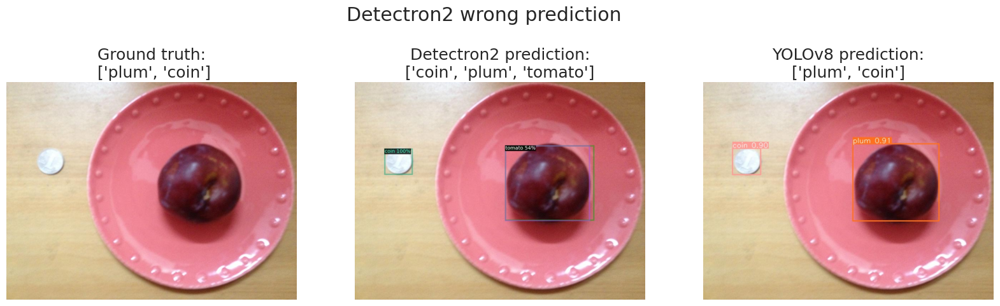

In [ ]:
for i,im in enumerate(df_det["image_with_preds"]):
    og = df_det["og_class"][i]
    det = df_det["pred_class"][i]
    yolo = df_yolo["pred_class"][i]
    if sorted(det) != sorted(yolo):
      fig, axes = plt.subplots(figsize=(20,6), ncols=3, nrows=1)
      if sorted(og) != sorted(yolo):
        plt.suptitle("YOLO wrong prediction")
      if sorted(og) != sorted(det):
        plt.suptitle("Detectron2 wrong prediction")
      if sorted(og) != sorted(yolo) and sorted(og) != sorted(det):
        plt.suptitle("Both wrong prediction")
      image = cv2.imread(df_det["image"][i])
      image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
      axes[0].imshow(image)
      axes[0].title.set_text('Ground truth:\n ' + og)
      axes[0].axis('off')
      image = cv2.imread(df_det["image_with_preds"][i])
      image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
      axes[1].imshow(image)
      axes[1].title.set_text('Detectron2 prediction:\n' + det)
      axes[1].axis('off')
      image = cv2.imread(df_yolo["image_with_preds"][i])
      image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
      axes[2].imshow(image)
      axes[2].title.set_text('YOLOv8 prediction:\n' + yolo)
      axes[2].axis('off')
      plt.show()